# Inverted pendulum
---

#Постановка задачи
С помощью алгоритма Proximal Policy Optimization необходимо обучить политику решающую две подзадачи:

1) Подъем маятника из нижнего положения в верхнее с последующей стабилизацией

2) Постановка конца маятника в соответствии с заданным положением в мировых координатах


# Среда

Среда представлена xml файлом.

In [1]:
!git clone https://github.com/NikaMorozova/PPO_invertedPendulum.git

Cloning into 'PPO_invertedPendulum'...
remote: Enumerating objects: 27, done.
remote: Counting objects: 100% (27/27), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 27 (delta 2), reused 27 (delta 2), pack-reused 0 (from 0)
Receiving objects: 100% (27/27), 27.70 MiB | 12.93 MiB/s, done.
Resolving deltas: 100% (2/2), done.


In [4]:
%cd PPO_invertedPendulum

/content/PPO_invertedPendulum



Среда с агентом:


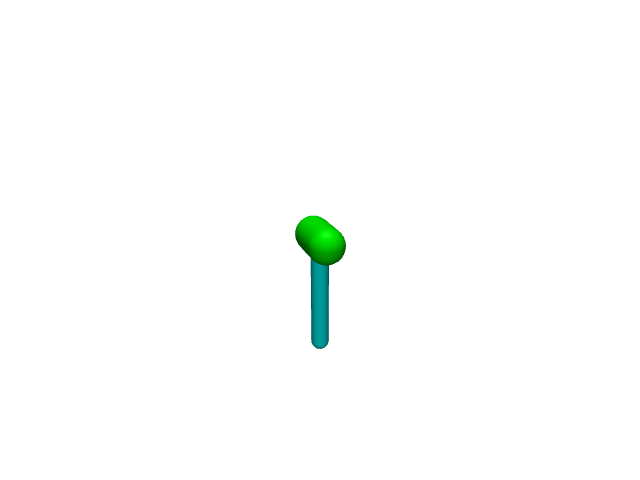

In [13]:
from IPython.display import Image, display


print("\nСреда с агентом:")
display(Image(filename="gifs/env_simulation.gif"))


## State space

![pendulum system](https://cdn.prod.website-files.com/625ec4bbe44f3510b4f59aaf/629f95ba2e4ec02eebff274f_01.jpg)

Система представлена следующим пространством состояний:

$x \in \mathbb{R}$ - позиция тележки;

$\dot{x} \in \mathbb{R}$ - скорость тележки (dx/dt);

$\theta \in [0, 2\pi] \ (theta)$ - угол маятника с массой $m$ относительрно вертикальной оси;

$\dot{\theta} \in \mathbb{R}$ - угловая скорость маятника с массой $m$;

Additional:

В данной задаче пространства наблюдений и состояний совпадают

Для постановки маятника в таргет вектор прстранства наблюдей расширяется и добавляется значение позиции таргета.

Помимо этих параметров, есть также переменные, которые могут быть заданы или изменены во время обучения:

$m$ - масса маятника, которая уже упомяналась выше;

$pos\_ball$ - позиция таргета (цели) - шарика, которому должен следовать маятник

## Action space
Continuous action space, составляющий пространство действий для агента:

1-element vector for actions;

continuous action in [-3, 3], where action represents the numerical force applied to the cart (with magnitude representing the amount of force and sign representing the direction)

### Mathematical model


Согласно представленному пространству действий, можно расписать следующие дифференциальные уравнения второго порядка

$$H_1(z)\ddot{z}=H_2(z,\dot{z})\dot{z}+h_3(z),$$

Где

$$z = (x, \theta)^T;$$

$$
h_3(z) =
\begin{bmatrix}
0 & a_g\sin\theta
\end{bmatrix}^T.
$$

$$H_1(z) =
\begin{bmatrix}
a_0 & a\cos\theta\\
a\cos\theta & b
\end{bmatrix};
$$

$$H_2(z, \dot{z}) =
\begin{bmatrix}
0 & a\sin\theta\dot{\theta}\\
0 & 0
\end{bmatrix};
$$

Где

$$a_0 = m;$$

$$a = ml.$$


### Initial state

Начальное состояние qpos="0 0 0 0" позиции тележки и маятника будут иметь начальную позицию в нулевых координат в среде (для маятника это -$\pi$), и qvel="0 0 0 0" — начальную скорость 0. Масса и инерция тележки и матяника:

Тележка: mass="1.0" inertia="0.1 0.1 0.1 0 0 0"
Маятник: mass="0.1" inertia="0.01 0.01 0.001 0 0 0" из файла, в ходе решения задачи в среде для случая, когда масса не задана, она определяется случайным значением из равномерного распределения.


### State space outline

В итоге среда рассматриваемой задачи представлена веткором состояний $s \in \mathbb{S} \subset \mathbb{R}^{5}$ с 5 переменными, одна из которых в интервале $[0, 2\pi]$.

## Решение задачи

Для решения поставленной задачи имплементируем алгоритм [Proximal Policy Optimization](https://arxiv.org/pdf/1707.06347). Все формулы и гиперпараметры основаны на данной статье.

#Дизайн функции награды
Перед нами стоит две задачи, которые необзодимо разделить на три:


*   Поднятие маятника
        следовательно необходимо решить задачу поиска оптимальной скорости тележки
        
        (изначально оптимального значения силы для тележки)
        
         для раскручивания матяника из начального положения
*   Уравновешивание матяника в вертикальном положении
*   Следования маятника в таргет


Первая и вторая задачи самая сложная: необходимо побудить тележку двигаться с целью поднятия маятника, предотвратив постоянное раскручивание. Для этого будем поощрять близость к нулю угла маятника с вертикалью (для этого используем косинус), штрафовать за высокую угловую и горизонтальную скорость, а также за удаление от центра координат.

Третья задача решается путем штрафа за удалении от таргета.

Итоговая функция награды:



```
"""
Если угол с вертикалью в пределах допустимого значения (0.2 радиана),
значит маятник уже в вертикальном положении и следует решать задачу следования в таргет,
сохраняя балансировку,
если угол не в заданном диапазоне - переходим к задаче поднятия маятника
"""
 if abs(ob[1]) < 0.15:
        if np.abs(x- target) < 0.1:
            alpha = 1
        else: alpha = -1
        reward = np.cos(theta) + np.exp(-np.abs(x- target)) * alpha
 else:
        reward = np.cos(theta) - 0.00001 * theta_dot**2 - 0.01 * x**2 - 0.00001 * x_dot**2
```




## Эксперименты
# Поднятие и Уравновешивание
Изначально, функция награды выглядела совсем не так и проводились различные эксперименты по ее изменению.

**Начнем** с экспериментов на поднятие маятника и стабилизацию.

Изначально рассматривалась награда, где был включен большой штраф за угловую и горизонтальную скорости, в итоге был получен следующий агент.


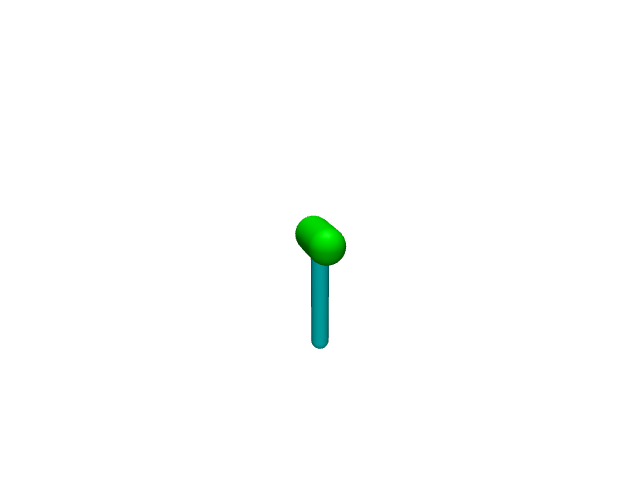

In [7]:
display(Image(filename="gifs/firstagent.gif"))

Он боялся достигнуть высокой скорости, что мешало поднятию маятника.

Затем был рассмотрен вариант награды, где поощерялось действие (модуль от приложенной силы), чтобы агент начал двигаться. В этом варианте был получен агент, который раскручивал маятник, но не балансировал его.

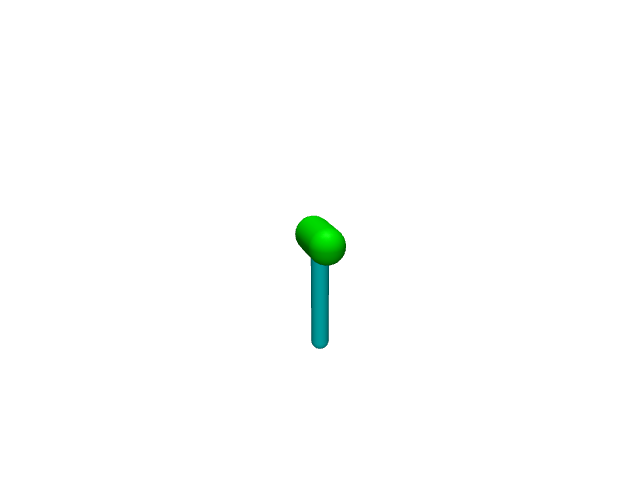

In [8]:
display(Image(filename="gifs/nextagent.gif"))

Наконец был рассмотрен вариант совершенно другой награды:

Поощрялось движение к вертикали, гравитационный момент и маленькое расстояние до таргета, штрафовались нарушения границ карты.

Данный подход привел к новому поведению у агента, он стал лучше понимать, в какую сторону надо двигаться, чтобы уравновесить маятник, но все же не достигал необзодимого угла с вертикалью.

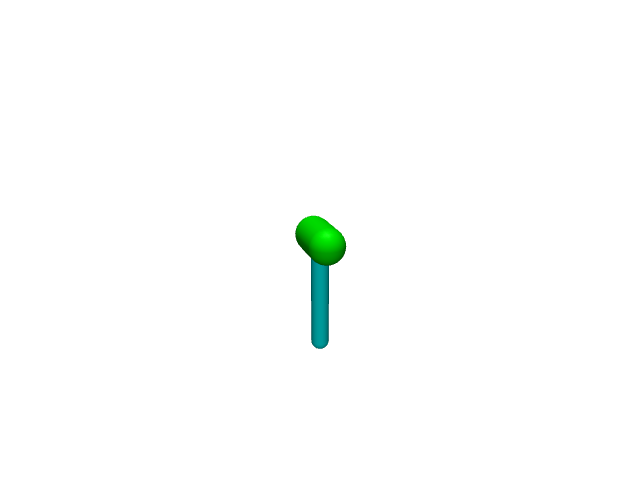

In [9]:
display(Image(filename="gifs/newagent.gif"))

И, наконец, итоговый вид награды привел к итоговому результату.

In [10]:
from ipywidgets import Video
smartagent = Video.from_file("gifs/yeeeywedidit.mp4",play=True,width=1400, height=1400)
smartagent

Video(value=b'\x00\x00\x00 ftypisom\x00\x00\x02\x00isomiso2avc1mp41\x00\x00\x85\x8cmoov\x00\x00\x00lmvhd\x00\x…

#Следование маятника в таргет с разными массами

Код запускался в colab, в связи с занятостью вычислительных ресурсов, поэтому визуализация была сделана через рендер без использования вьювера (в colab, как и в другой ВМ, нет монитора, в связи с этим ГЛ не инициализируется и необзодимо использовать рендер).

В связи с этим **далее** представлены эксперименты для разных значений массы после преобразования функции отрисовывания шарика и функции степа в классе среды из шаблона, шарик изначально отрисовывается в начале координат, затем каждые пять секунд времени среды обновляет позицию согласно равномерному распределению. (Мой любимый агент для массы 5 кг, он лучше других стоит у таргета).


Agent with pole mass 15


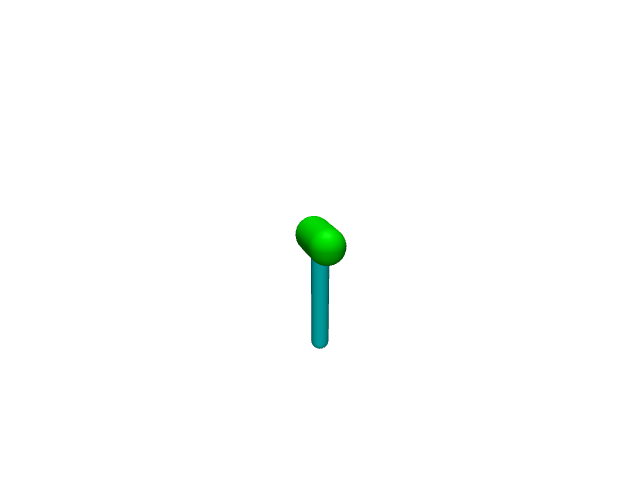

Agent with pole mass 5


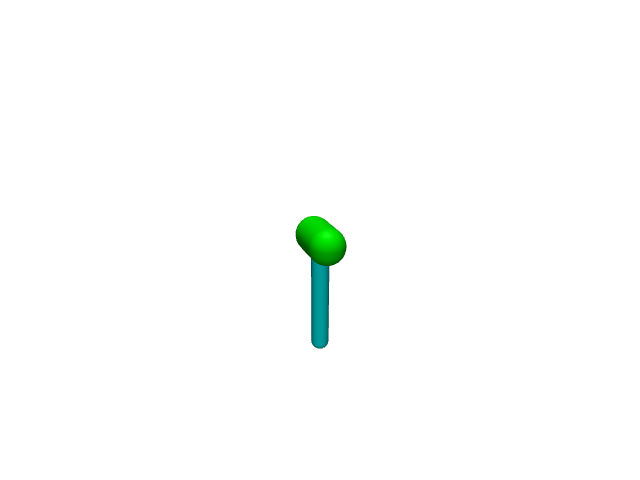

Agent with pole mass 3


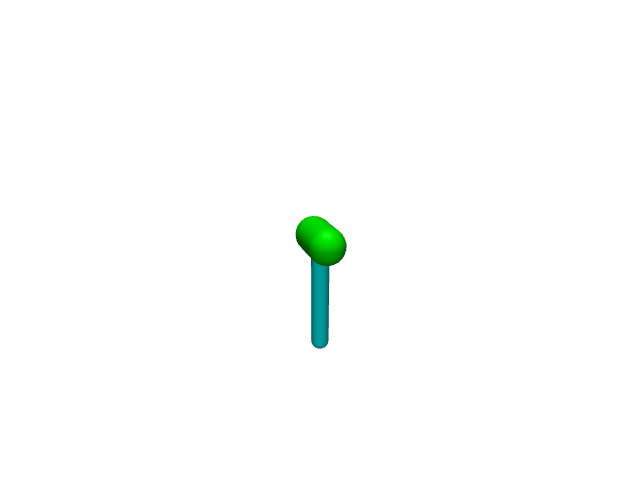

In [14]:
for i in [15, 5, 3]:
    print(f"Agent with pole mass {i}")
    display(Image(filename=f"gifs/env_simulation_{i}.gif"))


### Train and Evaluation of PPO model

Давайте поставим модель обучаться (нет смысла обучать модель с нуля сейчас, только покажем, что она учится)

![](https://i.pinimg.com/736x/1f/6b/5e/1f6b5e5c90be979afd042e161715ec3d.jpg)

In [14]:
pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 958.1/958.1 kB 24.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 315.4/315.4 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.5/243.5 kB 15.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 42.0 MB/s eta 0:00:00
  Attempting uninstall: imageio
    Found existing installation: imageio 2.37.0
    Uninstalling imageio-2.37.0:
      Successfully uninstalled imageio-2.37.0
  Attempting uninstall: gymnasium
    Found existing installation: gymnasium 1.1.1
    Uninstalling gymnasium-1.1.1:
      Successfully uninstalled gymnasium-1.1.1


In [30]:
!python main.py --run=Train --upswing=True --target=True

2025-06-24 07:55:46.791755: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750751746.820218   36013 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750751746.828659   36013 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-06-24 07:55:46.872794: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
PPO is training:   0% 0/500 [00:00<?, ?it/s]/content/ppo.py:134: UserWarning: Creating a tensor from a list of numpy.ndarrays

In [37]:
!python main.py --run=Test --upswing=True --target=True --actor_weights=actor.pth --critic_weights=critic.pth

2025-06-24 08:46:31.595159: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750754791.635846   48200 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750754791.644731   48200 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-06-24 08:46:31.679233: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
Renderer context created with dimensions: 640x480
0.02
/content/ppo.py:37: UserWarning: To copy construct from a tensor, it i

Максимальное значение награды равно 2 (в идеальном случае, когда маятник вертикален, а тележка на целевой позиции). За время экспериментов для ppo максимальный реворд удалось получить - 0.75 (за 1500 эпох). Хоть модель и ведет себя более-менее стабильно, было принято решение проверить работу в данной среде другого популярного подхода для задачи с континуальным пространтсвом действий - [DDPG](https://arxiv.org/pdf/1509.02971). Как и ожидалось, он сходился к тому же значению быстрее (к 450-й эпохе). Поскольку PPO является on-policy алгоритмом, данные, собранные в одном эпизоде, используются для одного (в данной имплементации) шага обновления политики. Их нельзя повторно использовать, как в DDPG с буфером опыта. Так, PPO требуется больше взаимодействия со средой для обучения.

Это сравнение было сугубо бонусным, и показывает только то, что конкретно для этой задачи DDPG сходится быстрее, но не обобщаем такой перформанс на все континууальные задачи.


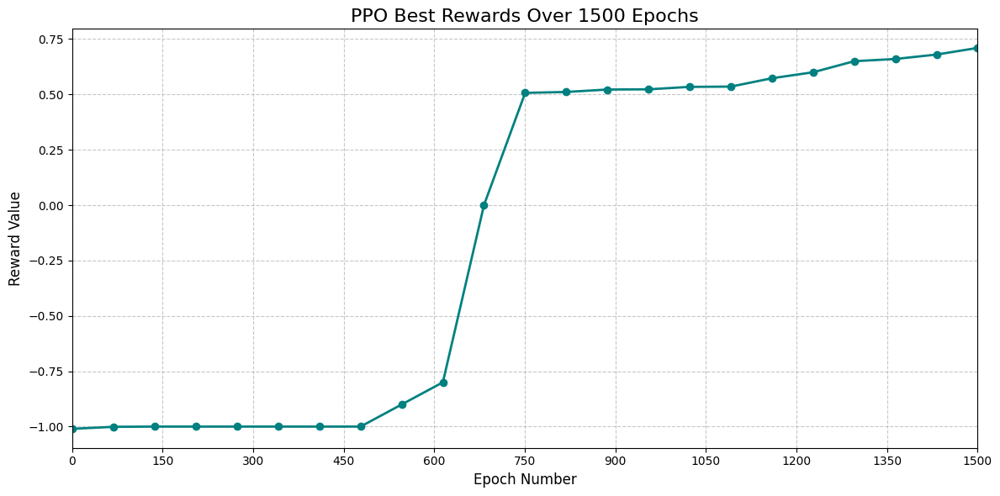

In [15]:
display(Image("gifs/ppo_1500.png"))

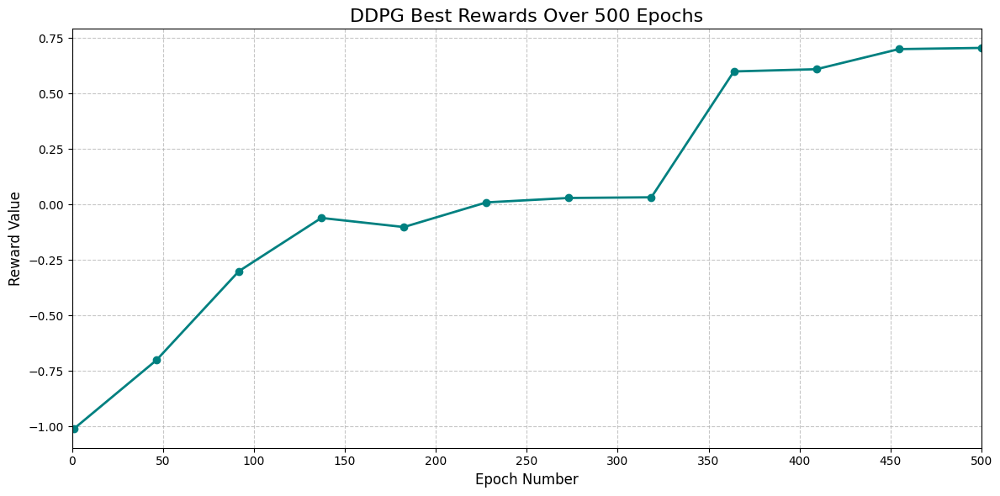

In [16]:
display(Image("gifs/ddpg_500.png"))